import pandas as pd
import geopandas as gpd
data = pd.read_csv('Cleaned/final.csv')
data = gpd.GeoDataFrame(
    data, geometry=gpd.points_from_xy(data.longitude, data.latitude))
data.crs = {'init': 'epsg:4326'}
data.head()

import pandas as pd
df = pd.read_csv('random_location.csv')
df = gpd.GeoDataFrame(
    df, geometry=gpd.points_from_xy(df.longitude, df.latitude))
df.crs = {'init': 'epsg:4326'}
df.head()
df.to_csv('random_location.csv', index=False)

In [13]:
import geopandas as gpd
import pandas as pd

# read file and take only the unique locations
data = pd.read_csv("cleaned/final.csv")
data = data.drop_duplicates(subset=['latitude', 'longitude'], keep='first')
print(data.head())
print(len(data))

        date   negeri code   daerah                         kawasan_banjir  \
0  29/4/2020  Sarawak  SRW  TANGKAK                    2. Kg Parit Bengkok   
1  10/5/2020  Sarawak  SRW   KLUANG                             Kg Bentong   
2  10/5/2020  Sarawak  SRW   KLUANG  Jalan Batu Pahat (Petron Tmn Berlian)   
3  10/5/2020  Sarawak  SRW   KLUANG                            Taman Intan   
4  10/5/2020  Sarawak  SRW   KLUANG                             Taman Emas   

   latitude  longitude  kedalaman_banjir_max  day  month  year  line_check  \
0    1.5203   103.9244                   0.5   29      4  2020           1   
1    2.0475   103.2973                   0.5   10      5  2020           1   
2    2.0173   103.2960                   0.5   10      5  2020           1   
3    2.0147   103.3009                   0.5   10      5  2020           1   
4    2.0205   103.2986                   0.5   10      5  2020           1   

                  geometry  
0  POINT (103.9244 1.5203)  
1  P

In [18]:
# change the geometry to meter
data = gpd.GeoDataFrame(data, geometry = gpd.points_from_xy(data.longitude, data.latitude), crs = "EPSG:4326")
two_mile_buffer = data.geometry.buffer(0.009)
two_mile_buffer.head()

C:\Users\Khor Kean Teng\AppData\Local\Temp\ipykernel_2676\341855106.py:3: UserWarning: Geometry is in a geographic CRS. Results from 'buffer' are likely incorrect. Use 'GeoSeries.to_crs()' to re-project geometries to a projected CRS before this operation.

  two_mile_buffer = data.geometry.buffer(0.009)


0    POLYGON ((103.93340 1.52030, 103.93336 1.51942...
1    POLYGON ((103.30630 2.04750, 103.30626 2.04662...
2    POLYGON ((103.30500 2.01730, 103.30496 2.01642...
3    POLYGON ((103.30990 2.01470, 103.30986 2.01382...
4    POLYGON ((103.30760 2.02050, 103.30756 2.01962...
dtype: geometry

In [19]:
# Turn group of polygons into single multipolygon
my_union = two_mile_buffer.geometry.unary_union
print('Type:', type(my_union))

# Show the MultiPolygon object
my_union

Type: <class 'shapely.geometry.multipolygon.MultiPolygon'>


In [20]:
# verify the shape on a map
# Create map with release incidents and monitoring stations
import geemap
import geemap.foliumap as geemap
import folium
from folium import GeoJson

m = geemap.Map(center=(4, 108), zoom=4)

# HeatMap(data=data[['latitude', 'longitude']], radius=15).add_to(m)
m.add_points_from_xy(data, x="longitude", y="latitude", icon_names=['gear', 'map', 'leaf', 'globe'])
    
# Plot each polygon on the map
m.add_geojson(GeoJson(two_mile_buffer.geometry.to_crs(epsg = 4326)).data, fill_colors=['blue'], layer_name = "Buffer Region")

m

In [22]:
# compute the flood and non flood area
import pandas as pd
location = pd.read_csv("data/random_location.csv")
location.head()

,latitude,longitude,region,state,postcode,geometry
0,6.402858,100.098777,Kangar,Perlis,1000,POINT (100.098777194727 6.402858213662168)
1,6.365790,100.188445,Kangar,Perlis,1000,POINT (100.1884449279714 6.365790268072505)
2,6.360280,100.212395,Kangar,Perlis,1000,POINT (100.2123950514647 6.360279611272917)
3,6.557335,100.314105,Kangar,Perlis,1000,POINT (100.31410538051875 6.557335215910892)
4,6.395771,100.230483,Kangar,Perlis,1000,POINT (100.23048302195971 6.395771260275012)


In [23]:
location = gpd.GeoDataFrame(location, geometry = gpd.points_from_xy(location.longitude, location.latitude), crs = "EPSG:4326")
location['flood_risk'] = my_union.contains(location.iloc[0:len(location)].geometry)
location.head()

,latitude,longitude,region,state,postcode,geometry,flood_risk
0,6.402858,100.098777,Kangar,Perlis,1000,POINT (100.09878 6.40286),False
1,6.365790,100.188445,Kangar,Perlis,1000,POINT (100.18844 6.36579),False
2,6.360280,100.212395,Kangar,Perlis,1000,POINT (100.21240 6.36028),False
3,6.557335,100.314105,Kangar,Perlis,1000,POINT (100.31411 6.55734),False
4,6.395771,100.230483,Kangar,Perlis,1000,POINT (100.23048 6.39577),False


In [24]:
# add this column to a new file for analysis
location.to_csv("regression_data.csv", index=False)

<Axes: xlabel='flood_risk', ylabel='count'>

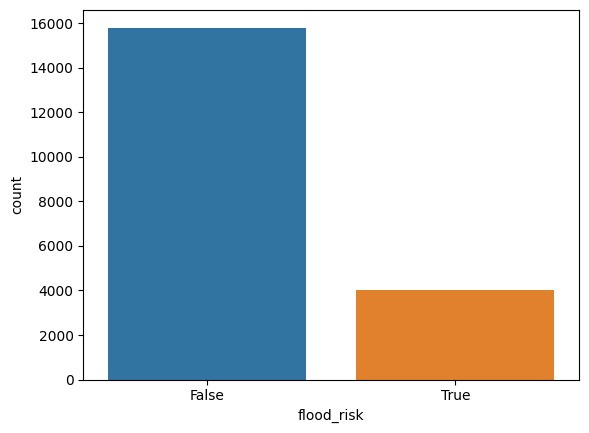

In [25]:
import seaborn as sns
sns.countplot(x = location['flood_risk'])

In [26]:
print(location['flood_risk'].value_counts())
print('Percentage of false: ', location['flood_risk'].value_counts()[0]/(location['flood_risk'].value_counts()[0] + location['flood_risk'].value_counts()[1]))
print('Percentage of true: ', location['flood_risk'].value_counts()[1]/(location['flood_risk'].value_counts()[0] + location['flood_risk'].value_counts()[1]))

flood_risk
False    15800
True      4024
Name: count, dtype: int64
Percentage of false:  0.7970137207425343
Percentage of true:  0.2029862792574657
